# BREAST CANCER DETECTION 

In [1]:
##IMPORTING NECESSARY  LIBRARIES
import pandas as pd
import numpy as np
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt

%matplotlib inline
import seaborn as sns
from skimage import io
sns.set()
from sklearn import svm
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.decomposition import PCA

from glob import glob
from os import listdir
import pickle

from tqdm.notebook import tqdm
tqdm().pandas();

print('import complete')


import complete


C:\Users\admin\anaconda3\lib\site-packages\tqdm\std.py:668: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [2]:
from os import listdir
files = listdir("Downloads/breast")
print(len(files)) # Displaying the number of patients

281


In [3]:
files[0:10] #Displaying only 10 patients

['10253',
 '10254',
 '10255',
 '10256',
 '10257',
 '10258',
 '10259',
 '10260',
 '10261',
 '10262']

Printing Directories for a patient

In [4]:
patient_file = listdir("Downloads/breast/13689")
print(len(patient_file))

2


In [5]:
#Displaying subfolders in every patient
print(patient_file)

['0', '1']


In [6]:
class_0 = listdir('Downloads/breast/13689/0')
class_1 = listdir('Downloads/breast/13689/1')

In [7]:
from pprint import pprint ##Displaying images in class 0 
print('Class 0 files:\n ')
pprint(class_0[0:10])##only 10 images

Class 0 files:
 
['13689_idx5_x1001_y1101_class0.png',
 '13689_idx5_x1001_y1151_class0.png',
 '13689_idx5_x1001_y1201_class0.png',
 '13689_idx5_x1001_y1301_class0.png',
 '13689_idx5_x1001_y151_class0.png',
 '13689_idx5_x1001_y201_class0.png',
 '13689_idx5_x1001_y251_class0.png',
 '13689_idx5_x1001_y451_class0.png',
 '13689_idx5_x1001_y651_class0.png',
 '13689_idx5_x1001_y701_class0.png']


In [8]:
print('Class 1 files:\n ')##Displaying images in class 1
pprint(class_1[0:10])##only 10 images

Class 1 files:
 
['13689_idx5_x1001_y1251_class1.png',
 '13689_idx5_x1001_y1351_class1.png',
 '13689_idx5_x1001_y1401_class1.png',
 '13689_idx5_x1001_y1451_class1.png',
 '13689_idx5_x1001_y1501_class1.png',
 '13689_idx5_x1001_y301_class1.png',
 '13689_idx5_x1001_y351_class1.png',
 '13689_idx5_x1001_y401_class1.png',
 '13689_idx5_x1051_y1351_class1.png',
 '13689_idx5_x1051_y1401_class1.png']


In [9]:
base_path = 'Downloads/breast/IDC_regular_ps50_idx5/'
patient_ids = listdir(base_path)

# LET US NOW DISPLAY THE TOTAL NUM OF PATCHES IN CLASS 0 AND 1 AND TOTAL PATCHES OF THE PATIENTS

In [10]:
class_0_total = 0
class_1_total = 0
from pprint import pprint
for patient_id in patient_ids:
    class_0_files = listdir(base_path + patient_id + '/0')
    class_1_files = listdir(base_path + patient_id + '/1')

    class_0_total += len(class_0_files)
    class_1_total += len(class_1_files) 

total_images = class_0_total + class_1_total
    
print(f'Number of patches in Class 0: {class_0_total}')
print(f'Number of patches in Class 1: {class_1_total}')
print(f'Total number of patches: {total_images}')

Number of patches in Class 0: 198738
Number of patches in Class 1: 78786
Total number of patches: 277524


Storing the image path , patient id , target , x and y coordinates

In [14]:
columns = ["patient_id",'x','y',"target","path"]
data_rows = []
i = 0
iss = 0
isss = 0

# note that we loop through the classes after looping through the 
# patient ids so that we avoid splitting our data into [all class 0 then all class 1]
for patient_id in patient_ids:
    for c in [0,1]:
        class_path = base_path + patient_id + '/' + str(c) + '/'
        imgs = listdir(class_path)
        
        # Extracting Image Paths
        img_paths = [class_path + img + '/' for img in imgs]
        
        # Extracting Image Coordinates
        img_coords = [img.split('_',4)[2:4] for img in imgs]
        x_coords = [int(coords[0][1:]) for coords in img_coords]
        y_coords = [int(coords[1][1:]) for coords in img_coords]

        for (path,x,y) in zip(img_paths,x_coords,y_coords):
            values = [patient_id,x,y,c,path]
            data_rows.append({k:v for (k,v) in zip(columns,values)})
# We create a new dataframe using the list of dicts that we generated above
data = pd.DataFrame(data_rows)
print(data.shape)
data.head()

(277524, 5)


,patient_id,x,y,target,path
0,10253,1001,1001,0,Downloads/breast/IDC_regular_ps50_idx5/10253/0...
1,10253,1001,1051,0,Downloads/breast/IDC_regular_ps50_idx5/10253/0...
2,10253,1001,1101,0,Downloads/breast/IDC_regular_ps50_idx5/10253/0...
3,10253,1001,1151,0,Downloads/breast/IDC_regular_ps50_idx5/10253/0...
4,10253,1001,1201,0,Downloads/breast/IDC_regular_ps50_idx5/10253/0...


Creating a visual summary of our data

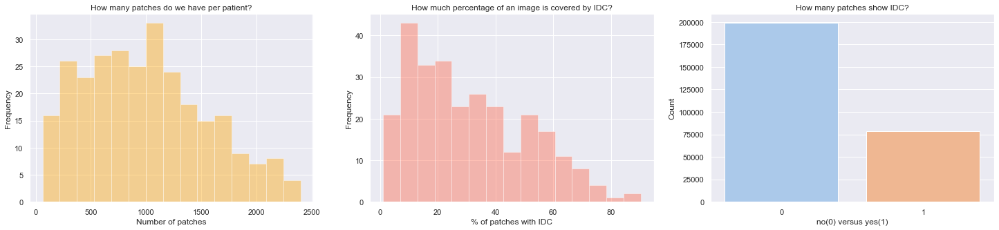

In [15]:
cancer_perc = data.groupby("patient_id").target.value_counts()/ data.groupby("patient_id").target.size()
cancer_perc = cancer_perc.unstack()

fig, ax = plt.subplots(1,3,figsize=(25,5))

# Plotting Frequency of Patches per Patient
sns.distplot(data.groupby("patient_id").size(), ax=ax[0], color="Orange", kde=False, bins=15)
ax[0].set_xlabel("Number of patches")
ax[0].set_ylabel("Frequency")
ax[0].set_title("How many patches do we have per patient?")

# Plotting Percentage of an image that is covered by Invasive Ductile Carcinoma
sns.distplot(cancer_perc.loc[:, 1]*100, ax=ax[1], color="Tomato", kde=False, bins=15)
ax[1].set_title("How much percentage of an image is covered by IDC?")
ax[1].set_ylabel("Frequency")
ax[1].set_xlabel("% of patches with IDC")

# Plotting number of patches that show IDC
sns.countplot(data.target, palette='pastel', ax=ax[2]);
ax[2].set_ylabel("Count")
ax[2].set_xlabel("no(0) versus yes(1)")
ax[2].set_title("How many patches show IDC?");

In [18]:
# Return random sample indexes that are cancer positive and cancer negative of size 50
# replace = False means that no duplication is allowed
positive_tissue = np.random.choice(data[data.target==1].index.values, size=100, replace=False)
negative_tissue = np.random.choice(data[data.target==0].index.values, size=100, replace=False)

n_rows = 10
n_cols = 10

Cancerous Patches

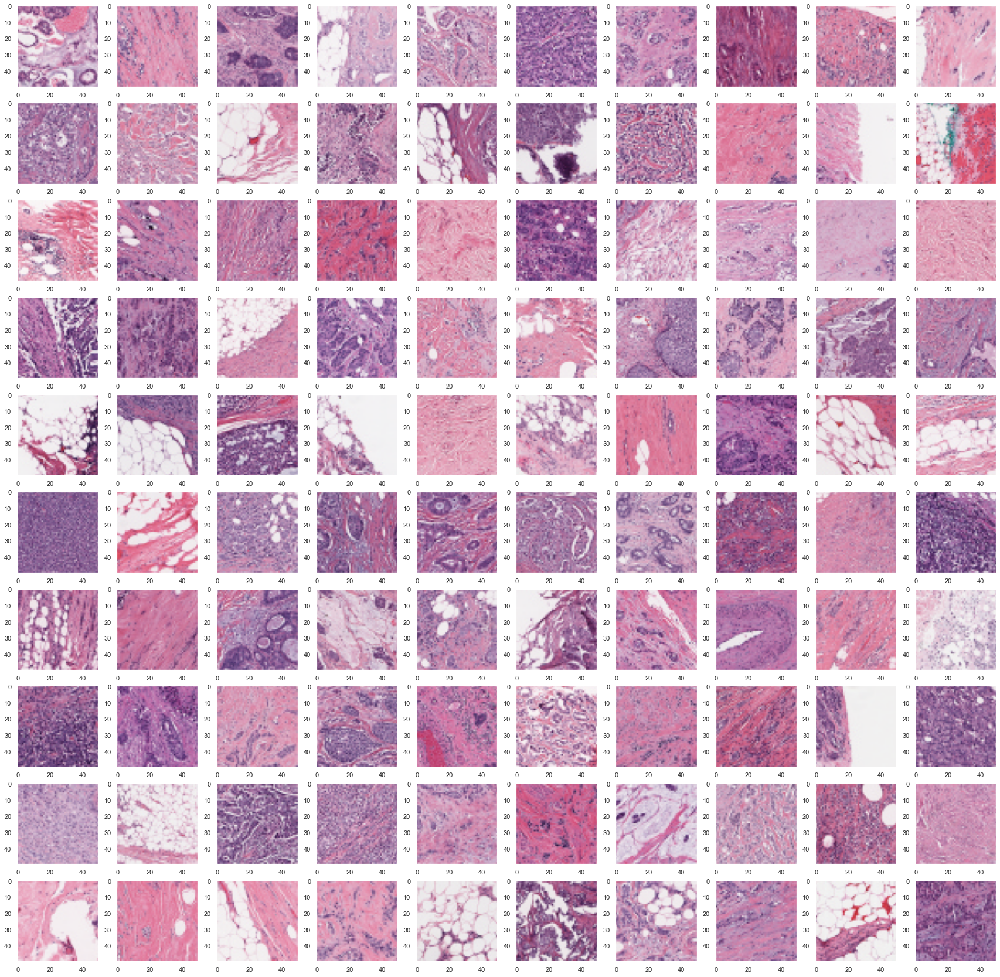

In [19]:
fig,ax = plt.subplots(n_rows,n_cols,figsize = (30,30))

for row in range(n_rows):
    for col in range(n_cols):
        # below is a counter to cycle through the image indexes
        idx = positive_tissue[col + n_cols*row]
        img = io.imread(data.loc[idx, "path"])
        ax[row,col].imshow(img[:,:,:])
        ax[row,col].grid(False)

Non Cancerous Patches

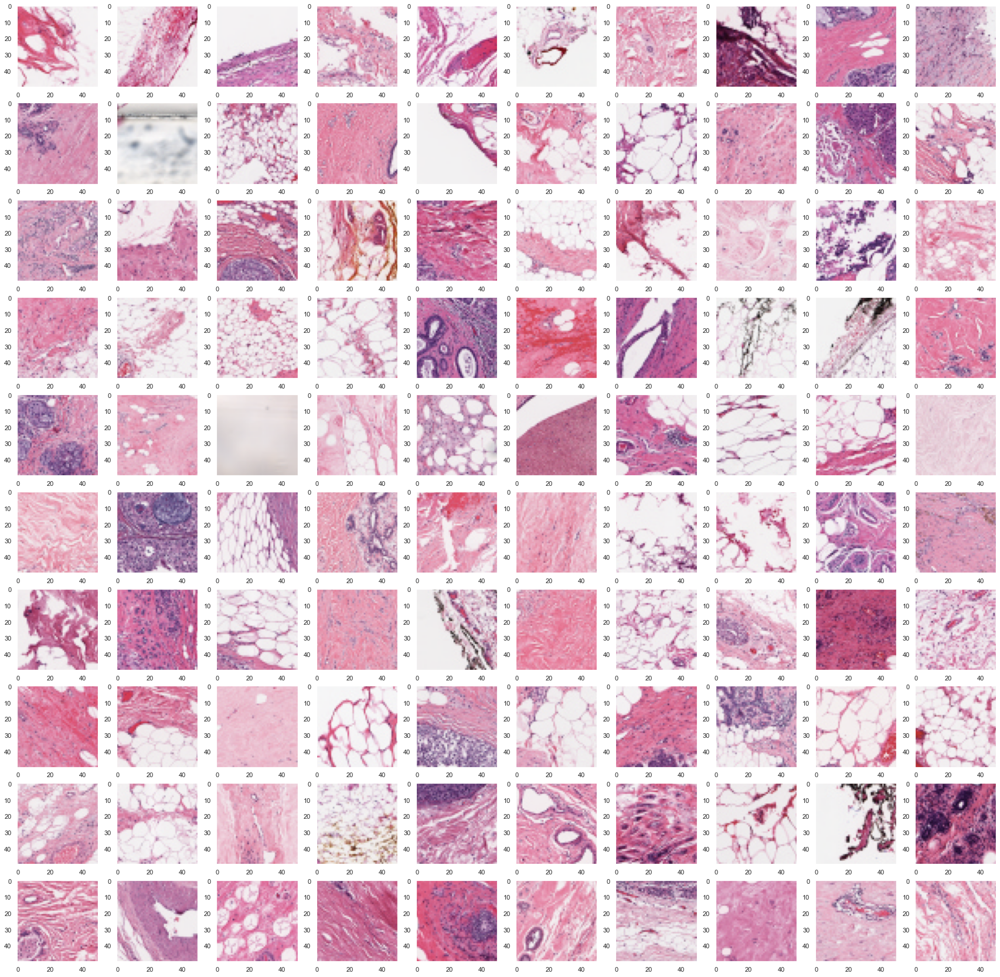

In [20]:
fig,ax = plt.subplots(n_rows,n_cols,figsize = (30,30))

for row in tqdm(range(n_rows)):
    for col in range(n_cols):
        # below is a counter to cycle through the image indices
        idx = negative_tissue[col + n_cols*row]
        img = io.imread(data.loc[idx, "path"])
        ax[row,col].imshow(img[:,:,:])
        ax[row,col].grid(False)

In [21]:
def get_patient_df(patient_id):
    return data.loc[data['patient_id']== patient_id,:]


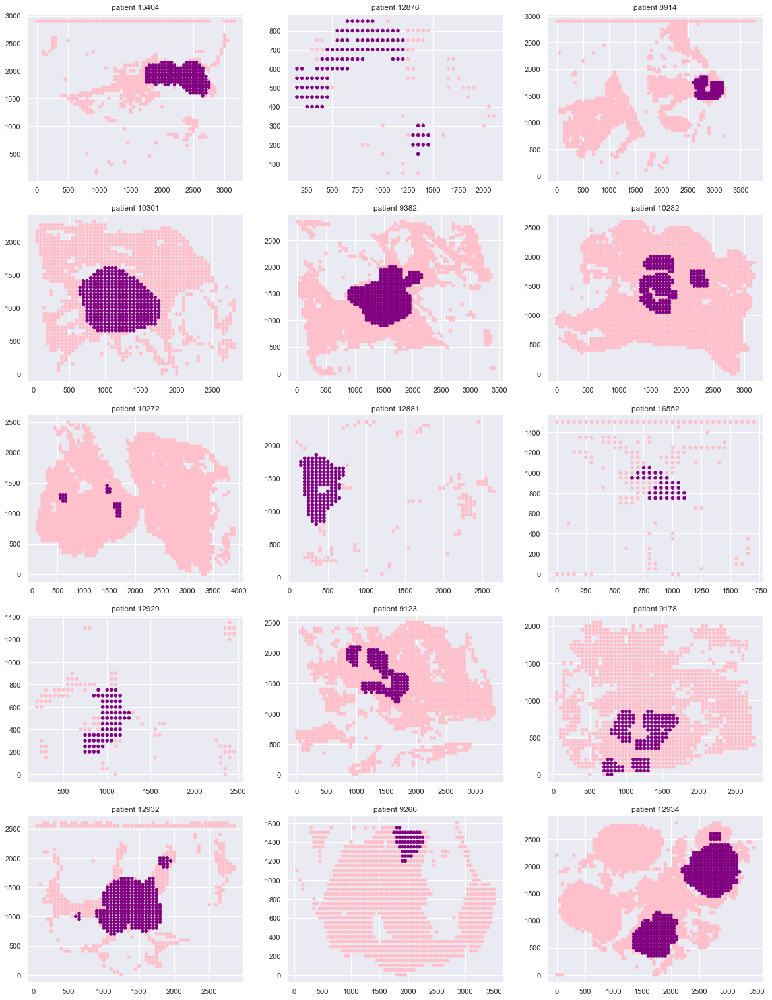

In [24]:
#Binary Target visualisation per tissue slice

n_rows = 5
n_cols = 3
n_imgs = n_rows*n_cols
colors = ['pink', 'purple']

fig, ax = plt.subplots(n_rows,n_cols,figsize=(20, 27))

patient_ids = np.random.choice( data.patient_id.unique(), size=n_imgs, replace=False)

for row in tqdm(range(n_rows)):
    for col in range(n_cols):
        patient_id = patient_ids[col + n_cols*row]
        patient_df = get_patient_df(patient_id)
        
        ax[row,col].scatter(patient_df.x.values, \
                            patient_df.y.values, \
                            c=patient_df.target.values,\
                            cmap=ListedColormap(colors), s=20)
        ax[row,col].set_title("patient " + patient_id)

In [25]:
def visualise_breast_tissue(patient_id, df = data,pred = False, crop_dimension = [50,50]):
    # Plotting Settings
    plt.xticks([])
    plt.yticks([])
    # Get patient dataframe
    p_df = get_patient_df(patient_id)
    # Get the dimensions of the breast tissue image
    max_coord = np.max((*p_df.x,*p_df.y))
    # Allocate an array to fill image pixels in,use uint8 type as you don't need an int over 255
    grid = 255*np.ones(shape = (max_coord + crop_dimension[0], max_coord + crop_dimension[1], 3)).astype(np.uint8)
    mask = 255*np.ones(shape = (max_coord + crop_dimension[0], max_coord + crop_dimension[1], 3)).astype(np.uint8)
    # Replace array values with values of the image
    for x,y,target,path in zip(p_df['x'],p_df['y'],p_df['target'],p_df['path']):
        try:
            img = io.imread(path)
            # Replace array values with cropped image values
            grid[y:y+crop_dimension[1],x:x+crop_dimension[0]] = img
            # Check if target is cancerous or not
            if target != 0:
                # If the target is cancerous then, replace array values with the color blue
                mask[y:y+crop_dimension[1],x:x+crop_dimension[0]] = [0,0,255]
        except: pass
    # if prediction is not specifies then show the image normally
    if pred == False:
        io.imshow(grid)
        img = grid
    # if prediction is specified then apply a mask to the areas that contain predicted cancerous cells
    else:
        # Specify the desired alpha value
        alpha = 0.78
        # This is step is very important, adding 2 numpy arrays sets the values to float64, which is why convert them back to uint8
        img = (mask * (1.0 - alpha) + grid * alpha).astype('uint8')
        io.imshow(img)
    return img


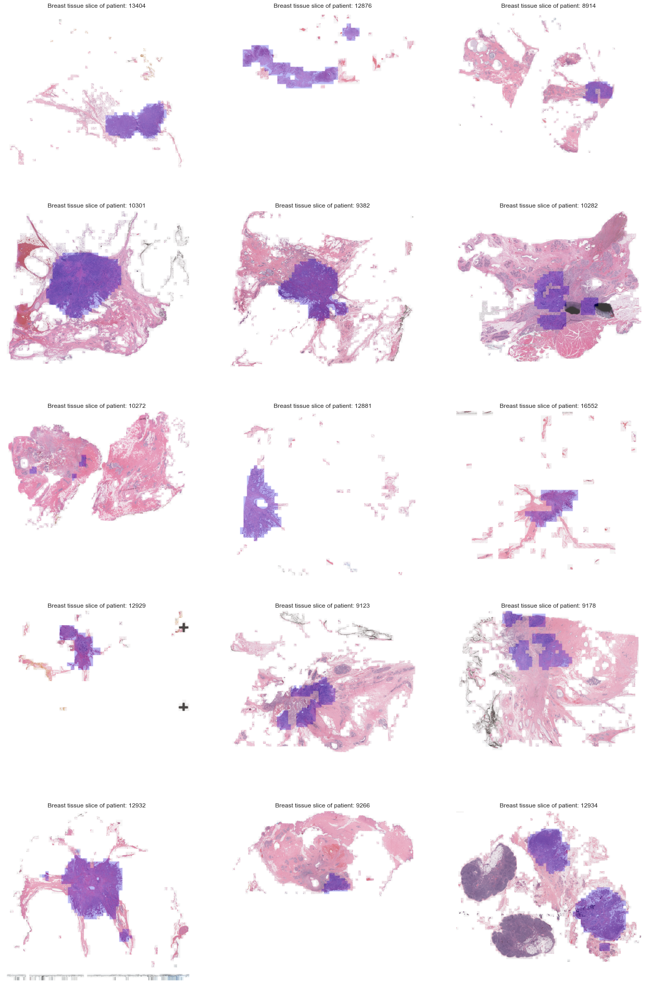

In [26]:
n_rows = 5
n_cols = 3
n_imgs = n_rows*n_cols

fig, ax = plt.subplots(n_rows,n_cols,figsize=(20, 27))

for row in tqdm(range(n_rows)):
    for col in range(n_cols):
        p_id = patient_ids[col + n_cols*row]
        
        img = visualise_breast_tissue(p_id, pred = True)
        ax[row,col].grid(False)
        ax[row,col].set_xticks([])
        ax[row,col].set_yticks([])
        ax[row,col].set_title("Breast tissue slice of patient: " + p_id)        
        ax[row,col].imshow(img)

In [22]:
def get_classes_split(series):
    ratio = np.round(series.value_counts()/series.count()*100,decimals = 1)
    return ratio

Data augmentation

In [23]:
import random
def shuffle_patients(frame):
    groups = [df for _, df in frame.groupby('patient_id')]
    random.shuffle(groups)
    shuffled_df = pd.concat(groups).reset_index(drop=True)
    return shuffled_df

In [24]:
from sklearn.model_selection import train_test_split
for i in range(3):
    data = shuffle_patients(data)
    display(data.head())

,patient_id,x,y,target,path
0,15840,1001,1001,0,Downloads/breast/IDC_regular_ps50_idx5/15840/0...
1,15840,1001,1051,0,Downloads/breast/IDC_regular_ps50_idx5/15840/0...
2,15840,1001,1101,0,Downloads/breast/IDC_regular_ps50_idx5/15840/0...
3,15840,1001,1151,0,Downloads/breast/IDC_regular_ps50_idx5/15840/0...
4,15840,1001,1201,0,Downloads/breast/IDC_regular_ps50_idx5/15840/0...


,patient_id,x,y,target,path
0,10307,1001,1001,0,Downloads/breast/IDC_regular_ps50_idx5/10307/0...
1,10307,1001,1051,0,Downloads/breast/IDC_regular_ps50_idx5/10307/0...
2,10307,1001,1101,0,Downloads/breast/IDC_regular_ps50_idx5/10307/0...
3,10307,1001,1251,0,Downloads/breast/IDC_regular_ps50_idx5/10307/0...
4,10307,1001,1301,0,Downloads/breast/IDC_regular_ps50_idx5/10307/0...


,patient_id,x,y,target,path
0,15510,1001,1251,0,Downloads/breast/IDC_regular_ps50_idx5/15510/0...
1,15510,1001,1301,0,Downloads/breast/IDC_regular_ps50_idx5/15510/0...
2,15510,1001,1351,0,Downloads/breast/IDC_regular_ps50_idx5/15510/0...
3,15510,1001,1401,0,Downloads/breast/IDC_regular_ps50_idx5/15510/0...
4,15510,1001,1501,0,Downloads/breast/IDC_regular_ps50_idx5/15510/0...


In [25]:
(get_classes_split(data['target']))

0    71.6
1    28.4
Name: target, dtype: float64

Splitting our Data into training and testing

In [26]:

from sklearn.model_selection import train_test_split

def split_data(data,train_test_percentage = 0.7,percentage_of_dataset = 0.2):
    # get number of datapoints to split from the total dataset
    n_points = round(data.shape[0]*0.2)
    # retrieve the desired initial split of the data based on the specified percentage of the dataset
    data = data[0:n_points]
    # retrieve all the columns except the target columns and store them in X
    X = data.loc[:,data.columns != 'target']
    # retrieve the target column and store them in y 
    y = data.loc[:,['target']]
    # Split the model to training and testing sets for both the features and the targets
    X_train, X_test, y_train, y_test =  train_test_split(X, y, train_size=train_test_percentage, shuffle = False)
    return [X_train, X_test, y_train, y_test]

In [27]:
X_train, X_test, y_train, y_test = split_data(data)

In [29]:
print(f'Number of Training samples: {X_train.shape[0]} ')
print(f'Number of Testing samples: {X_test.shape[0]} ')

Number of Training samples: 38853 
Number of Testing samples: 16652 


In [30]:
print('Training data split:')
display(get_classes_split(y_train.target))
print('Testing data split:')
display(get_classes_split(y_test.target))

Training data split:


0    67.0
1    33.0
Name: target, dtype: float64

Testing data split:


0    69.5
1    30.5
Name: target, dtype: float64

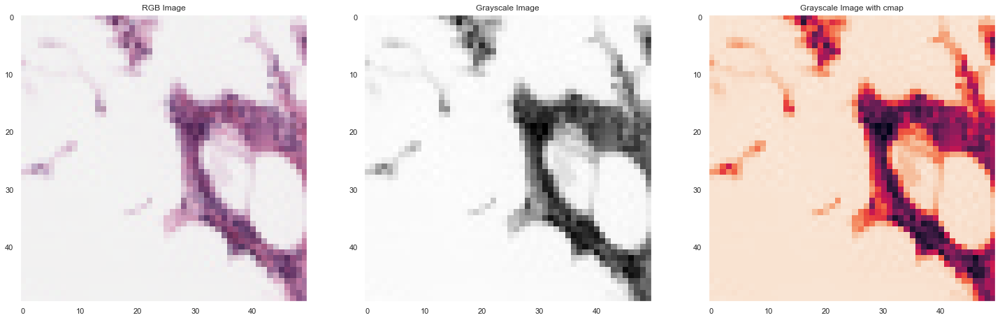

In [31]:
# path to images
img_path = X_train.path[0]
# reading the images
rgb_img = io.imread(img_path)
gray_img = io.imread(img_path, as_gray = True) # careful when spelling the word gray
# plot images
fig,ax = plt.subplots(1,3, figsize = (25,50))
ax[0].grid(False)
ax[1].grid(False)
ax[2].grid(False)
# set titles
ax[0].set_title('RGB Image')
ax[1].set_title('Grayscale Image')
ax[2].set_title('Grayscale Image with cmap')
# display images
ax[0].imshow(rgb_img)
ax[1].imshow(gray_img,cmap = 'gray')
ax[2].imshow(gray_img)

In [32]:
print(f'rgb image dimension: {rgb_img.shape}')
print(f'grayscale image dimension: {gray_img.shape}')

rgb image dimension: (50, 50, 3)
grayscale image dimension: (50, 50)


In [33]:
def paths_to_array(paths,n_pixels = 2500):
    imgs_array = np.zeros((paths.shape[0],n_pixels))
    for i,path in tqdm(enumerate(paths),total = imgs_array.shape[0]):
        # Read image
        img = io.imread(path,as_gray = True)
        # Flatten image
        img = img.flatten()
        # Store image in corresponding array row
        imgs_array[i,0:img.shape[0]] = img
    return imgs_array

In [34]:
# Store paths inside variable
paths = X_train.path
# Convert paths to array of images
imgs_array = paths_to_array(paths)
imgs_array.shape

(38853, 2500)

In [35]:
imgs_array_mean = imgs_array.mean(axis = 1)

In [36]:
X_train['img_mean'] = imgs_array_mean

In [57]:
import plotly_express as px

avg_fig = px.histogram(X_train, x = "img_mean", color = y_train.target,marginal = "violin")
avg_fig.update_layout(barmode = 'overlay') # choose stack, overlay, relative or group
avg_fig.update_traces(opacity = 0.75)
avg_fig.update_layout(title_text = 'mean image distribution')
avg_fig.show()

In [38]:
def avg_quadrants(flat_img):
    # get the shape of the image array 
    shape = np.sqrt(flat_img.shape[0]).astype(int)
    shape_2 = (shape/2).astype(int)
    # reshape the flat image in order to extract the quadrants
    img = flat_img.reshape(shape,shape)
    # get the mean value for each quadrant
    top_left = img[:shape_2,:shape_2].mean()
    top_right = img[:shape_2,shape_2:].mean()
    bottom_right = img[shape_2:,shape_2:].mean()
    bottom_left = img[shape_2:,:shape_2].mean()
    
    return [top_left,top_right,bottom_left,bottom_right]

In [39]:
def get_quadrant_array(imgs_array):
    # initialize array of zeros
    avg_quad_array = np.zeros((imgs_array.shape[0],4))
    # loop through imgs_array and get the averages for each quadrant
    for i in tqdm(range(imgs_array.shape[0])):
        flat_img = imgs_array[i]
        quad_avgs = avg_quadrants(flat_img)
        avg_quad_array[i] = quad_avgs
    return avg_quad_array

In [40]:
avgs_array = get_quadrant_array(imgs_array)

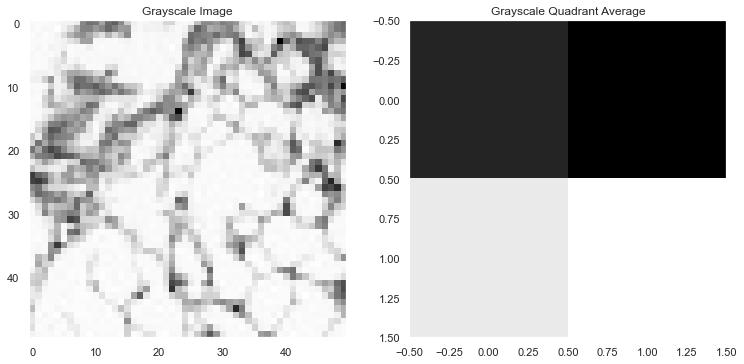

In [41]:
rand_n = np.random.randint(imgs_array.shape[0])
# reading the images
gray_img = imgs_array[rand_n].reshape(50,50)
quad_img = avgs_array[rand_n].reshape(2,2)
# plot images
fig,ax = plt.subplots(1,2, figsize = (12.5,25))
ax[0].grid(False)
ax[1].grid(False)
# set titles
ax[0].set_title('Grayscale Image')
ax[1].set_title('Grayscale Quadrant Average')
# display images
ax[0].imshow(gray_img,cmap = 'gray')
ax[1].imshow(quad_img,cmap = 'gray')

In [42]:
# create a new pandas dataframe using the numpy average quadrant image data
avg_quad_df = pd.DataFrame(avgs_array, columns = ['top_left','top_right','bottom_left','bottom_right'])

In [43]:
avg_quad_df.head()

,top_left,top_right,bottom_left,bottom_right
0,0.904208,0.754086,0.941493,0.784780
1,0.892154,0.798880,0.860025,0.743324
2,0.855956,0.748188,0.785263,0.564906
3,0.618039,0.475711,0.749297,0.824185
4,0.880218,0.905864,0.776765,0.921692


In [44]:
# Remember to store dataframes in a tuple, and axis = 1
X_train = pd.concat((X_train,avg_quad_df), axis = 1) 
X_train.head()

,patient_id,x,y,path,img_mean,top_left,top_right,bottom_left,bottom_right
0,15510,1001,1251,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.846142,0.904208,0.754086,0.941493,0.784780
1,15510,1001,1301,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.823596,0.892154,0.798880,0.860025,0.743324
2,15510,1001,1351,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.738578,0.855956,0.748188,0.785263,0.564906
3,15510,1001,1401,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.666808,0.618039,0.475711,0.749297,0.824185
4,15510,1001,1501,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.871135,0.880218,0.905864,0.776765,0.921692


In [58]:
# Top Left no cancer 
TL_no_c = X_train.loc[y_train.target == 0,'top_left']
# Top Left with cancer
TL_c = X_train.loc[y_train.target == 1,'top_left']
# Top Right no cancer 
TR_no_c = X_train.loc[y_train.target == 0,'top_right']
# Top Right with cancer
TR_c = X_train.loc[y_train.target == 1,'top_right']
# Bottom Left no cancer 
BL_no_c = X_train.loc[y_train.target == 0,'bottom_left']
# Bottom Left with cancer
BL_c = X_train.loc[y_train.target == 1,'bottom_left']
# Bottom Right no cancer 
BR_no_c = X_train.loc[y_train.target == 0,'bottom_right']
# Bottom Right with cancer
BR_c = X_train.loc[y_train.target == 1,'bottom_right']

In [59]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots
fig = make_subplots(
    rows=2, cols=2, subplot_titles=("Top Left Quadrant", "Top Right Quadrant", "Bottom Left Quadrant", "Bottom Right Quadrant")
)


# Add traces
fig.add_trace(go.Histogram(x=TL_no_c), row=1, col=1)
fig.add_trace(go.Histogram(x=TL_c), row=1, col=1)

fig.add_trace(go.Histogram(x=TR_no_c), row=1, col=2)
fig.add_trace(go.Histogram(x=TR_c), row=1, col=2)

fig.add_trace(go.Histogram(x=BL_no_c), row=2, col=1)
fig.add_trace(go.Histogram(x=BL_c), row=2, col=1)

fig.add_trace(go.Histogram(x=BR_no_c), row=2, col=2)
fig.add_trace(go.Histogram(x=BR_c), row=2, col=2)

# Update xaxis properties
fig.update_xaxes(title_text="Average Top Left Quadrant Values", showgrid=False, row=1, col=1)
fig.update_xaxes(title_text="Average Top Right Quadrant Values", showgrid=False, row=1, col=2)
fig.update_xaxes(title_text="Average Bottom Left Quadrant Values", showgrid=False, row=2, col=1)
fig.update_xaxes(title_text="Average Bottom Right Quadrant Values", showgrid=False, row=2, col=2)

# Update yaxis properties
fig.update_yaxes(title_text="Count", showgrid=False, row=1, col=1)
fig.update_yaxes(title_text="Count", showgrid=False, row=1, col=2)
fig.update_yaxes(title_text="Count", showgrid=False, row=2, col=1)
fig.update_yaxes(title_text="Count", showgrid=False, row=2, col=2)

# Update title and height
fig.update_layout(title_text="Average Quadrant Data Split", height=700)

fig.show()


In [47]:
X_train.head()

,patient_id,x,y,path,img_mean,top_left,top_right,bottom_left,bottom_right
0,15510,1001,1251,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.846142,0.904208,0.754086,0.941493,0.784780
1,15510,1001,1301,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.823596,0.892154,0.798880,0.860025,0.743324
2,15510,1001,1351,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.738578,0.855956,0.748188,0.785263,0.564906
3,15510,1001,1401,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.666808,0.618039,0.475711,0.749297,0.824185
4,15510,1001,1501,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.871135,0.880218,0.905864,0.776765,0.921692


# Training our model

In [48]:
#setting model parameters
from sklearn.svm import SVC
svc = SVC(kernel = 'rbf',gamma = 'auto' )
svc_n = SVC(gamma = 'auto')

In [49]:
X_train.head()

,patient_id,x,y,path,img_mean,top_left,top_right,bottom_left,bottom_right
0,15510,1001,1251,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.846142,0.904208,0.754086,0.941493,0.784780
1,15510,1001,1301,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.823596,0.892154,0.798880,0.860025,0.743324
2,15510,1001,1351,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.738578,0.855956,0.748188,0.785263,0.564906
3,15510,1001,1401,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.666808,0.618039,0.475711,0.749297,0.824185
4,15510,1001,1501,Downloads/breast/IDC_regular_ps50_idx5/15510/0...,0.871135,0.880218,0.905864,0.776765,0.921692


In [50]:
X_train = X_train.loc[:,['img_mean','top_left','top_right','bottom_left','bottom_right']]
X_train.head()

,img_mean,top_left,top_right,bottom_left,bottom_right
0,0.846142,0.904208,0.754086,0.941493,0.784780
1,0.823596,0.892154,0.798880,0.860025,0.743324
2,0.738578,0.855956,0.748188,0.785263,0.564906
3,0.666808,0.618039,0.475711,0.749297,0.824185
4,0.871135,0.880218,0.905864,0.776765,0.921692


In [51]:
#Fitting our model
svc.fit(X_train,y_train)

C:\Users\admin\anaconda3\lib\site-packages\sklearn\utils\validation.py:73: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



SVC(gamma='auto')

In [52]:
svc.score(X_train,y_train)

0.7473811546083957

In [53]:
from sklearn.metrics import confusion_matrix

tn, fp, fn, tp = confusion_matrix(svc.predict(X_train),y_train).ravel()

print(f'Training set: true negatives: {tn}')
print(f'Training set: true positives: {tp}')
print(f'Training set: false negatives: {fn}')
print(f'Training set: false positives: {fp}')

Training set: true negatives: 23505
Training set: true positives: 5533
Training set: false negatives: 2512
Training set: false positives: 7303


In [60]:
# save the model to disk

filename = 'finalized_breast_cancer_model'
pickle.dump(svc, open(filename, 'wb'))

In [61]:
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
result = loaded_model.score(X_train, y_train)
print(result)

0.7473811546083957
